
# Chemometrics
<br>




fecha: 10/10/2017

In [73]:
options(repr.plot.width=5, repr.plot.height=5)

# statistical methods applied to MP

## about variables

<small>
 - independent variables (experimental, predictors) are those that we manipulate during an experiment
 - dependent variables are the one we try to explain

<br>*we test the effect of IV on DV. We study the effect of age (IV) and lecture skills (IV) on academic performances (marks, DV). The latter depend on the former. A high or low mark will **never** affect the lecture skills.*

- In statistics, independent variables are causes and dependent variables are effects. 

- <font color='green'>
It is important to know how many IV and DV we have, since it will guide us to pick the correct method.
</font>
</small>

<br><div class="ref" style="font-size:12px;">
https://statistics.laerd.com/statistical-guides/types-of-variable.php<br>
http://www.allanalytics.com/author.asp?section_id=1413&doc_id=252823
</div>


### categorical and continuous variables
 - Nominal (names: Colombia, Burkina Faso)
 - Dichotomous (male or female, the one usually exclude the other)
 - Ordinal (low, middle, high)
 - Continous variables
  - interval (0 C is not ratio)
  - ratio (0 K is a ratio, because it means no temperature at all)



### decision tree

<center><img src="../img/arbre.png" width="400"></center>

<small>
**by knowing the kind and number of variables we can use such a decision tree to guide us among the many methods**

<font style="color:blue"> It goes behond the scope of this classe to study all of them, but we will use the tree for the several example we want to study deeper in.</font>

</small>

<div class="ref" style="font-size:12px;">
Taken from Ennos, R. 2007. Statistical and Data Handling Skills in Biology. Harlow, U.K., Pearson Education Limited
</div>


In [55]:
# we load a few packages
library(ggplot2)
library(corrplot)
library(reshape2)
library(caret)
library(MASS) # for LDA
library(klaR) # for pls
library(pls)
library(e1071)# for pls
library(pROC) # for pls
library(vegan)
require(scales)
require(gridExtra);

In [466]:
rm(list=ls(all=TRUE))

load('/Users/jul/metabo/paper_IRMS/coffeeMulti.rda')
d <- coffeeMulti$irms

In [467]:
summary(d$country)

Brasil Colombia     Peru 
      11       15        8

In [468]:
d[1:3,]
# uncomment the following line to run only two classes
#levels(d$country) <- c("otros","Colombia","otros")

,code,country,department,caffeine1,caffeine2,mean
5,1172,Colombia,Tolima,-28.285,-27.936,-28.111
6,1173,Colombia,Tolima,-28.931,-28.8,-28.866
7,1198,Brasil,Otro,-28.056,-28.274,-28.165


In [465]:
#options(repr.plot.width=5, repr.plot.height=3)
png(file = '../img/distributions3.png', width=20, height=8, units="cm",res=1200)

mean=100; sd=15
lb=80; ub=120

x <- seq(-4,4,length=100)*sd + mean
hx <- dnorm(x,mean,sd)

par(mfrow=c(1,2))

plot(x, hx, type="n", xlab="", ylab="",
  main="", axes=FALSE,xlim=c(0,250))

i <- x >= lb & x <= ub
lines(x, hx)
lines(x+10, hx, col="red")
axis(1, at=seq(40, 260, 20), pos=0)

plot(x, hx, type="n", xlab="", ylab="",
  main="", axes=FALSE,xlim=c(0,250))

i <- x >= lb & x <= ub
lines(x, hx)
lines(x+100, hx, col="red")
axis(1, at=seq(40, 260, 20), pos=0)

dev.off();

Cairo 
    2

<center>
<img src="../img/distributions3.png" width="800">
</center>

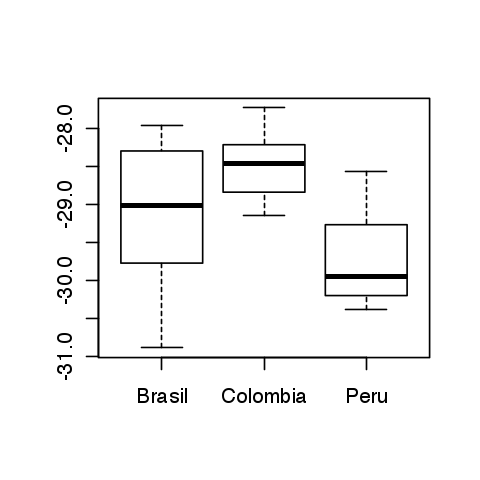

In [469]:
boxplot(tapply(d$mean,d$country,function(x) x))

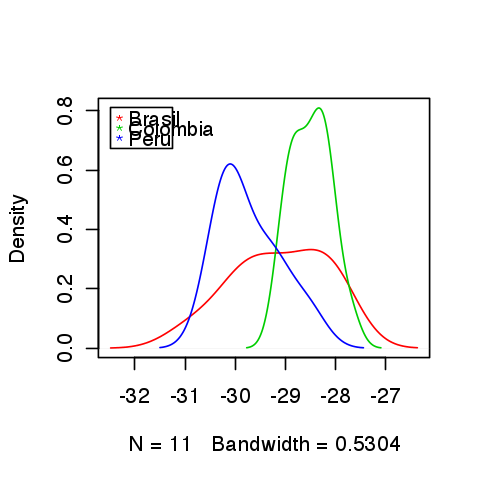

In [470]:
# here we plot the distribution for each class
x <- tapply(d$mean,d$country,function(x) x)
xlims <- range(unlist(tapply(d$mean,d$country,function(x) unlist(range(density(x)$x)))))
ylims <- range(unlist(tapply(d$mean,d$country,function(x) unlist(range(density(x)$y)))))
plot(density(x[1][[1]]),type='l', xlim=xlims, ylim=ylims, col=2, main=" ")
lines(density(x[2][[1]]), col=3)
lines(density(x[3][[1]]), col=4)
legend(min(xlims),max(ylims),levels(d$country), col=2:4, pch="*")

In [471]:
# then we start the calculations
means <- tapply(d$mean,d$country,mean)      # means
vars <- tapply(d$mean,d$country,var)        # variances
sds <- sqrt(vars)                           # standard deviation
ns <- tapply(d$mean,d$country,length)
# we perform a multiple t-test, that is we calculate t-test between
# all the pairs of countries, and compute the p-values
# from http://www.chem.utoronto.ca/coursenotes/analsci/stats/ttest.html
t <- dist(means) / sqrt( abs(combn(sds^2/ns,2,sum)) )
dof <- abs(combn(sds^2/ns,2,sum))^2 / combn(sds^4/(ns^2*(ns - 1)),2,sum)
#dof <- sum(ns) - length(levels(d$country)) # sometimes the d.o.f are also computed in that simpler manner
p <- 2*pt(-abs(t),df=dof);

In [472]:
t
dof
p

           Brasil Colombia
Colombia 2.052607         
Peru     1.634253 4.976158

[1] 12.61633 16.90348 10.12954

               Brasil     Colombia
Colombia 0.0614565181             
Peru     0.1206906508 0.0005354635

In [473]:
t.test(d$mean[d$country=="Brasil"], d$mean[d$country=="Colombia"])


	Welch Two Sample t-test

data:  d$mean[d$country == "Brasil"] and d$mean[d$country == "Colombia"]
t = -2.0526, df = 12.616, p-value = 0.06146
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -1.28761786  0.03492695
sample estimates:
mean of x mean of y 
-29.12955 -28.50320 


In [475]:
var.test(d$mean[d$country=="Peru"], d$mean[d$country=="Colombia"])


	F test to compare two variances

data:  d$mean[d$country == "Peru"] and d$mean[d$country == "Colombia"]
F = 2.4574, num df = 7, denom df = 14, p-value = 0.1443
alternative hypothesis: true ratio of variances is not equal to 1
95 percent confidence interval:
  0.7270675 11.2946238
sample estimates:
ratio of variances 
          2.457439 


In [454]:
p.adjust(c(0.0614565181, 0.1206906508, 0.0005354635), "bonferroni")

[1] 0.18436955 0.36207195 0.00160639

In [151]:

# this complex caluclation can be replaced by this single line
m <- t.test(d$mean[d$country=="Co"],d$mean[d$country=="Br"])
m2 <- t.test(d$mean[d$country=="Co"],d$mean[d$country=="Pe"])
m3 <- t.test(d$mean[d$country=="Br"],d$mean[d$country=="Pe"])


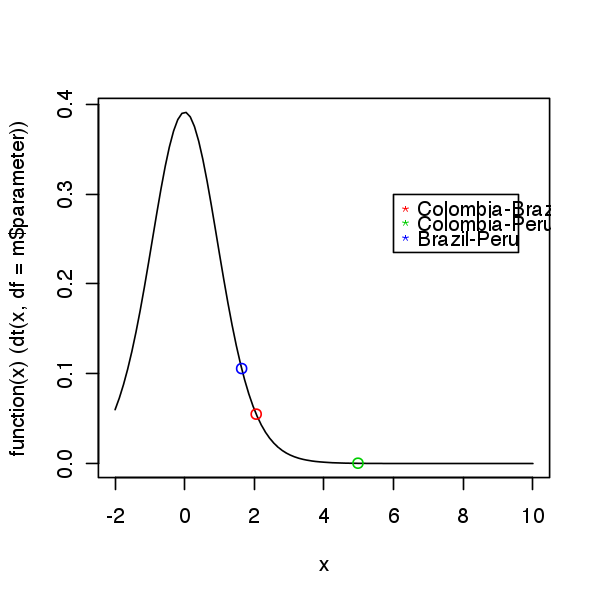

In [152]:
plot(function(x)(dt(x,df=m$parameter)),xlim=c(-2,10)); points(m$statistic,dt(m$statistic,df=m$parameter), col=2, xlab=("d"))
points(m2$statistic,dt(m2$statistic,df=m2$parameter), col=3)
points(m3$statistic,dt(m3$statistic,df=m3$parameter), col=4)
legend(6,0.3,c("Colombia-Brazil", "Colombia-Peru", "Brazil-Peru"), col=2:4, pch="*")


### Conclusion
- we cannot discriminate coffees from those 3 countries based on IRMS data

But

 - multiple t-test is not well suited because the 5% error is multiplicative this means that for 3 tests with 5% error each, the global error is approx 15% 
 - Moreover, t-test assumes 1) homogeneity of variance, 2) normal distributions within all groups and 3) independant variables.

In [159]:
#ANOVA fixes the first two issues. For non-normal distribution use Kruskal-W
#allis test. In this case the test reject the null hypothesis meaning that t
#he populations are NOT identical. 
# annova is best suited for that purpose
fit <- aov(mean ~ country, data=d)
summary(fit)

            Df Sum Sq Mean Sq F value   Pr(>F)    
country      2  8.064   4.032   8.879 0.000894 ***
Residuals   31 14.077   0.454                     
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

In [157]:
# F-value is Mean Sq Residuals / Mean Sq country
pf(8.879,2,31,lower.tail = FALSE)
# the p-value is small indicating that the distribution's difference is
# significant


[1] 0.0008941185

In [158]:
# Kruskal-Wallis test is in principle suited for comparison of population that
# are different in size. Small p-values indicates that the null hypothesis is
# safely rejected: populations are too far apart and cannot be explained by randomness.
kruskal.test(mean ~ country, data=d)



	Kruskal-Wallis rank sum test

data:  mean by country
Kruskal-Wallis chi-squared = 11.506, df = 2, p-value = 0.003174


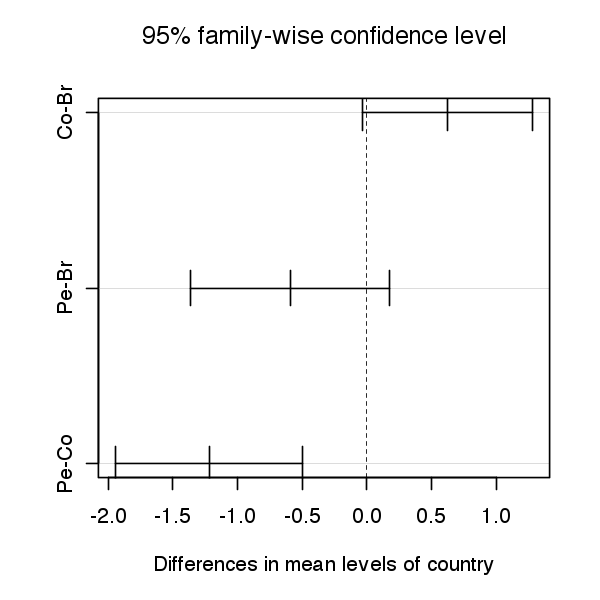

In [163]:
# since data exhibits significance... fortunately,
# post hoc test can be performed to understand how well pairwise populations
# can be separated
#TukeyHSD(fit, "country", ordered = TRUE);
plot(TukeyHSD(fit, "country"))

### conclusion

- Peru is different from  Colombia
- Colombia cannot be distinguished from Brazil
- Peru and Brazil cannot be distinguished


## let's look at GC-MS data

we load data of 7 compounds:
- caffein
- vitamin E
- sitosterol
- hexadecanoic acid
- furanmethanol
- tocopherol

In [197]:
rm(list=ls(all=TRUE))

load('/Users/jul/metabo/paper_IRMS/coffeeMulti.rda')

d <- coffeeMulti$gc                       # select GCMS data
#d <- data.frame("x"=coffeeMulti$gc[5:11],"country"=coffeeMulti$gc$country) 

#par(mfrow=c(3,3))
# first we have a look to the data... this is rule number one!

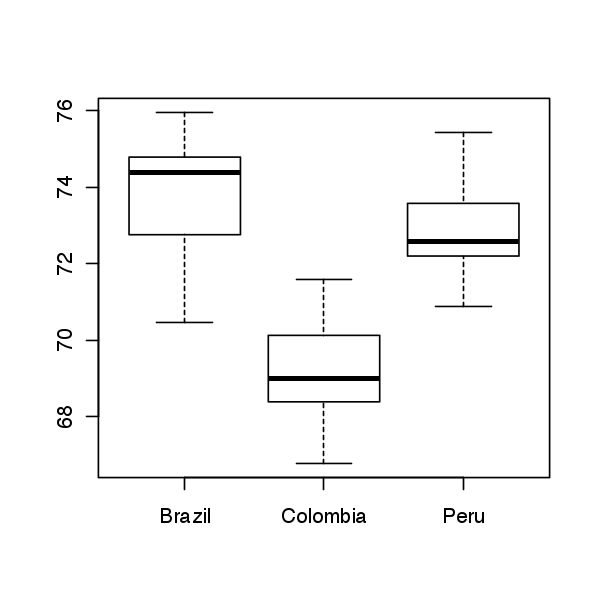

In [198]:
d <- data.frame("x"=coffeeMulti$gc$caffeine,"country"=coffeeMulti$gc$country) #31.87
boxplot(tapply(d$x,d$country,function(x) x))


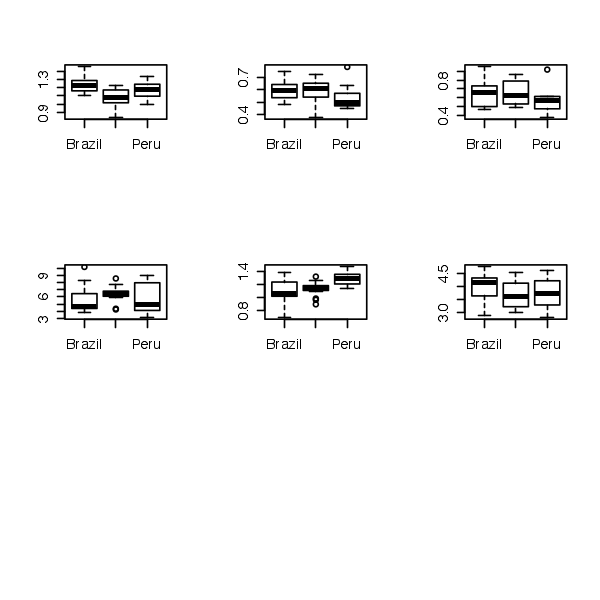

In [199]:
par(mfrow=c(3,3))
d <- data.frame("x"=coffeeMulti$gc$vitE,"country"=coffeeMulti$gc$country) #6.14 alias a-tocopherol
boxplot(tapply(d$x,d$country,function(x) x))
d <- data.frame("x"=coffeeMulti$gc$stigmasterol,"country"=coffeeMulti$gc$country) #1.21
boxplot(tapply(d$x,d$country,function(x) x))
d <- data.frame("x"=coffeeMulti$gc$sitosterol,"country"=coffeeMulti$gc$country) #0.93
boxplot(tapply(d$x,d$country,function(x) x))
d <- data.frame("x"=coffeeMulti$gc$hexadecanoicAcid,"country"=coffeeMulti$gc$country) #0.584
boxplot(tapply(d$x,d$country,function(x) x))
d <- data.frame("x"=coffeeMulti$gc$furanmethanol,"country"=coffeeMulti$gc$country) #4.76
boxplot(tapply(d$x,d$country,function(x) x))
d <- data.frame("x"=coffeeMulti$gc$tocoferol,"country"=coffeeMulti$gc$country) #1.14
boxplot(tapply(d$x,d$country,function(x) x))

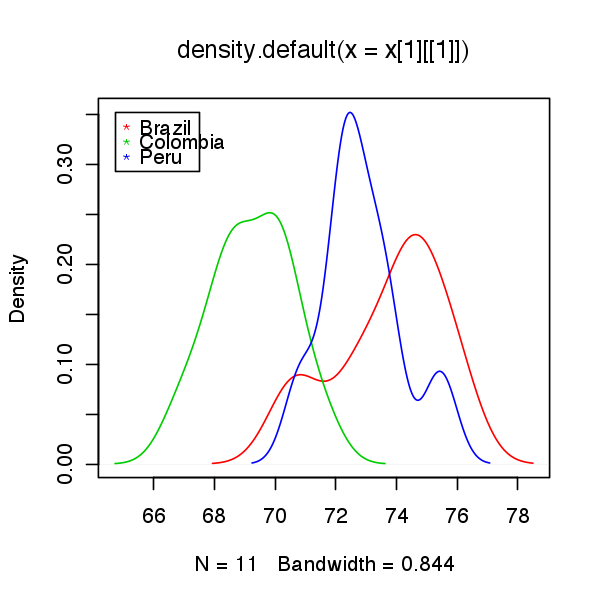

In [201]:
# here we plot the distribution for each class
d <- data.frame("x"=coffeeMulti$gc$caffeine,"country"=coffeeMulti$gc$country) #31.87
x <- tapply(d$x,d$country,function(x) x)
xlims <- range(unlist(tapply(d$x,d$country,function(x) unlist(range(density(x)$x)))))
ylims <- range(unlist(tapply(d$x,d$country,function(x) unlist(range(density(x)$y)))))
plot(density(x[1][[1]]),type='l', xlim=xlims, ylim=ylims, col=2)
lines(density(x[2][[1]]), col=3)
lines(density(x[3][[1]]), col=4)
legend(min(xlims),max(ylims),levels(d$country), col=2:4, pch="*")


## Let's load some NMR data

In [214]:
rm(list=ls(all=TRUE))

load('/Users/jul/metabo/paper_IRMS/coffeeMulti.rda')
load('/Users/jul/metabo/paper_IRMS/ppm.binned.rda')

t<-coffeeMulti$gc$country; #levels(t)<-c("o", "c","o" )
# we perform ANOVA on the nmr data. 
#d <- data.frame("x"=I(as.matrix(coffeeMulti$nmrBin)),"country"=coffeeMulti$gc$country)
d <- data.frame("x"=I(as.matrix(coffeeMulti$nmrBin)),"country"=t)
colnames(d$x) <- round(ppm.binned,3) # put ppm of bins as tag for data column. This will be helpfull for tracking variables.
fit <- aov(x ~ country, data=d)
resultsF <- unlist( lapply(summary(fit),function(x) x[[4]][1]) ) # we extract F-values
# extract the p-value of K-W test for all NMR variables
#resultsK_W.p <- apply(d$x, 2, function(x) kruskal.test(x ~ coffeeMulti$gc$country)$p.value)
resultsK_W.p <- apply(d$x, 2, function(x) kruskal.test(x ~ t)$p.value)


# we look at some results to have an idea
b <- head(order(resultsF, decreasing = TRUE), 200) # select the most discriminant variable for further analysis
best <- b[1]
#best = 1150
d <- data.frame("x"=coffeeMulti$nmrBin[,best],"country"=t)
#d <- data.frame("x"=coffeeMulti$nmrBin[,best],"country"=coffeeMulti$gc$country)

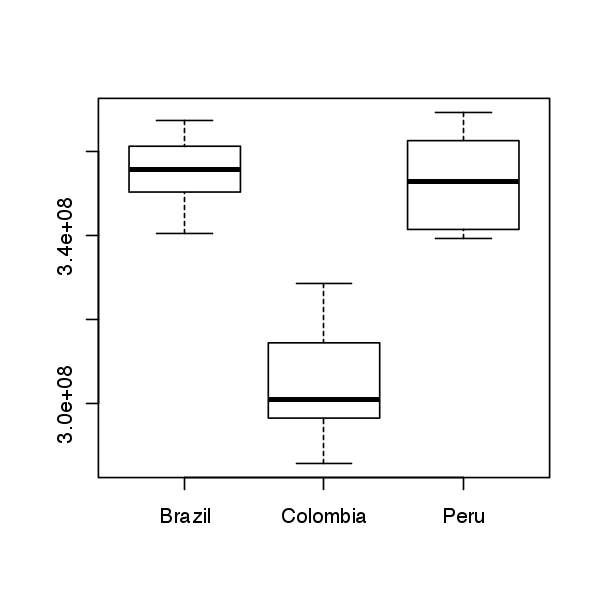

In [215]:
boxplot(tapply(d$x,d$country,function(x) x))

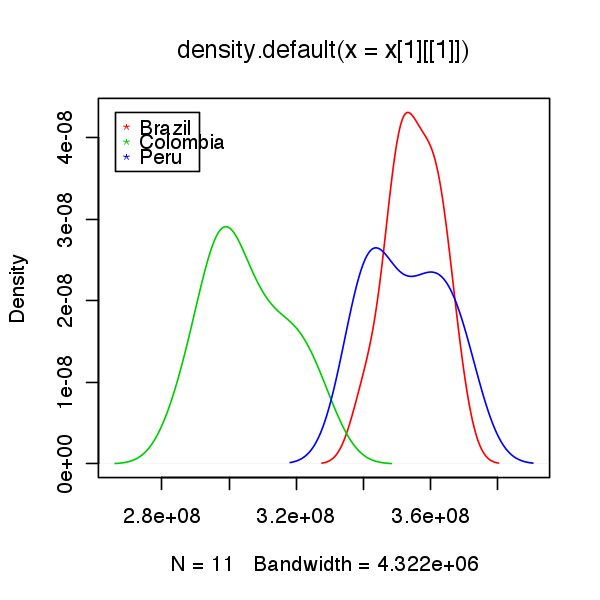

In [220]:
# here we plot the distribution for each class
x <- tapply(d$x,d$country,function(x) x)
xlims <- range(unlist(tapply(d$x,d$country,function(x) unlist(range(density(x)$x)))))
ylims <- range(unlist(tapply(d$x,d$country,function(x) unlist(range(density(x)$y)))))
plot(density(x[1][[1]]),type='l', xlim=xlims, ylim=ylims, col=2)
lines(density(x[2][[1]]), col=3)
lines(density(x[3][[1]]), col=4)
legend(min(xlims),max(ylims),levels(d$country), col=2:4, pch="*")

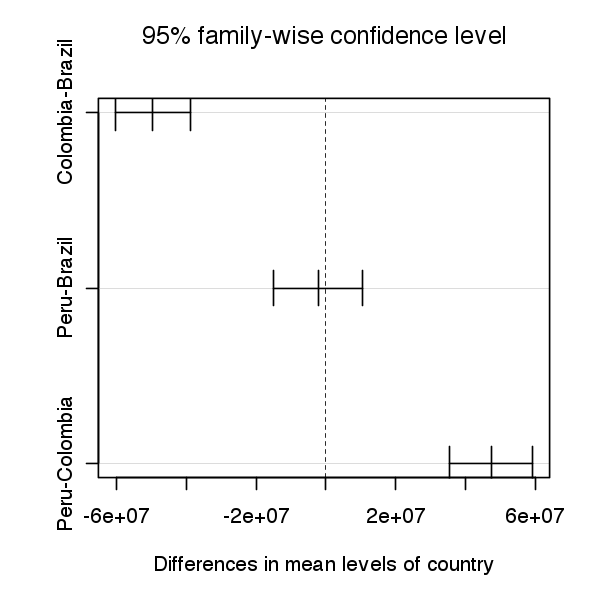

In [223]:
fit <- aov(as.matrix(d$x) ~ country, data=d)
#TukeyHSD(fit, "country", ordered = TRUE);
plot(TukeyHSD(fit, "country")); 

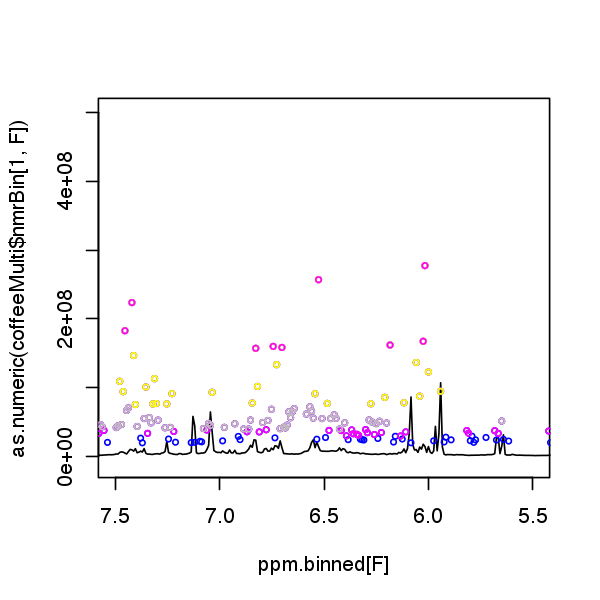

In [226]:
F <- resultsF > 4
index <- 1:length(resultsF)
plot(ppm.binned[F],as.numeric(coffeeMulti$nmrBin[1,F]), type="n", ylim=c(-1e7,5e8), xlim=c(7.5,5.5))
lines(ppm.binned,as.numeric(coffeeMulti$nmrBin[1,]), col=1)
for (i in c(4,6,8,15,30)) {
  F <- resultsF > i
  index <- 1:length(resultsF)
  points(ppm.binned[F],resultsF[F]*5e6,cex=0.5, col=i)
}

In [235]:
options(repr.plot.width=8, repr.plot.height=3)

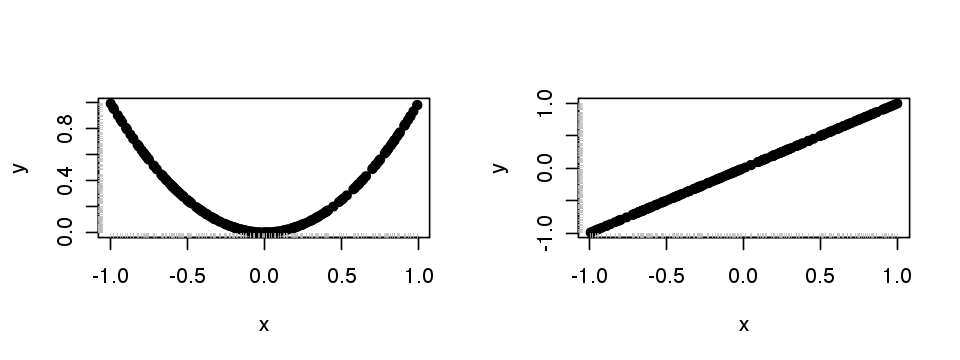

In [239]:
par(mfrow=c(1,2))

x <- runif(200,min=-1,max=1)
y <- x^2
plot(x,y,pch=16)
rug(x,side=1,col="grey")
rug(y,side=2,col="grey")
#cor(x,y);
#chisq.test(x,y) ;

x <- runif(200,min=-1,max=1)
y <- x
plot(x,y,pch=16)
rug(x,side=1,col="grey")
rug(y,side=2,col="grey")
#cor(x,y);
#chisq.test(x,y) ;

Despite in both cases $x$ and $y$ are dependent, in the left case they are completely uncorrelated. So being uncorrelated is not the same as being independent, but independant variables are uncorrelated. Two variables are considered independent when their joint probability distribution is equal to the product of their individual marginal probability distributions: $$P_{X,Y}(x,y)=P_X(x)P_Y(y)$$

Two variables are uncorrelated when their correlation coefficient is zero or when their covariance is equal to zero.


### high number of variable

- The number of available variables (predictors) is much higher that the number of observation
- overfitting 
- reduce the number of variables a task that is achieved by step-wise regression, etc.  



## multivariate analysis

However there are others and more robust alternatives to these methods that aknowledge the redundancy of information spanned by collinear predictors and try to convert collinearity of predictors (an issue) into reliability (a plusvalue). 


In [304]:
options(repr.plot.width=4, repr.plot.height=4)
load('/Users/jul/metabo/paper_IRMS/resultsF.rda')
load('/Users/jul/metabo/paper_IRMS/coffeeMulti.rda')
load('/Users/jul/metabo/paper_IRMS/ppm.binned.rda')
colnames(coffeeMulti$nmrBin) <- round(ppm.binned,3)
country <- coffeeMulti$gc$country 
irms <- abs(coffeeMulti$irms$mean) 
vite <- coffeeMulti$gc$vitE
caff <- coffeeMulti$gc$caffeine 
fumeth <- coffeeMulti$gc$furanmethanol
ffilter <- resultsF > 15
x <- cbind(irms,
           vite,
           caff,
           fumeth,
           as.matrix(coffeeMulti$nmrBin[,ffilter]))

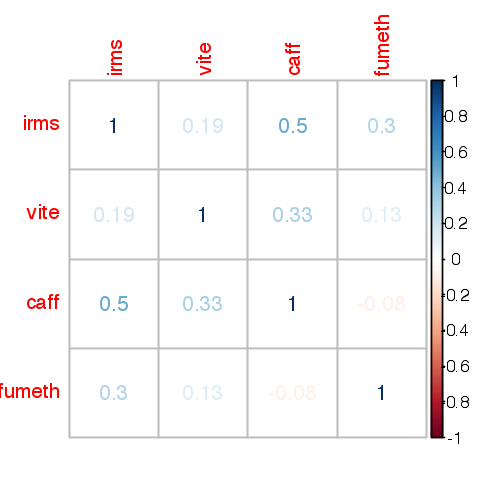

In [305]:
corrplot::corrplot(cor(cbind(irms, vite, caff, fumeth)),
                   method='number')


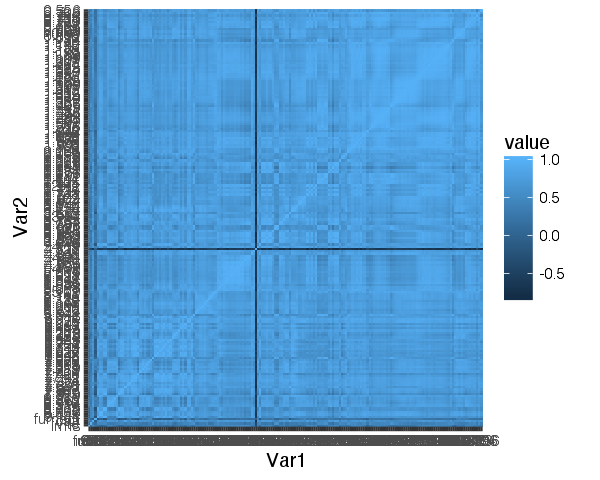

In [306]:
options(repr.plot.width=5, repr.plot.height=4)
qplot(x=Var1, y=Var2, data=melt(cor(x)), fill=value, geom="tile")


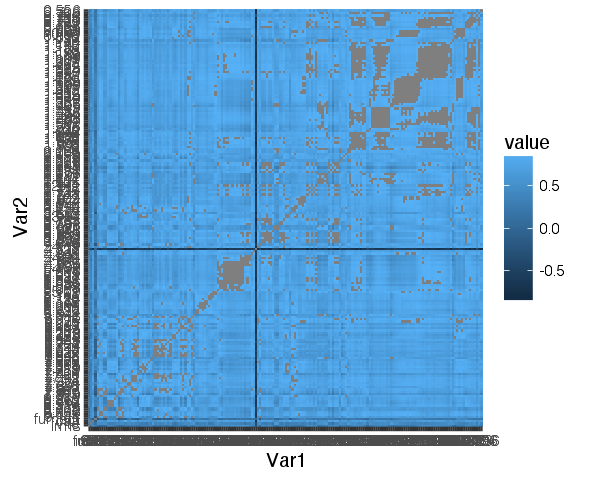

In [307]:
M <- cor(x)
M[M > 0.9] <- NA
qplot(x=Var1, y=Var2, data=melt(M), fill=value, geom="tile")


In [308]:
C <- findCorrelation(cor(x), 
                     cutoff = .90, 
                     verbose = FALSE)
x <- x[ , -C ]

fvalues <- c(8.879,4.14,31.87,4.76,resultsF[ffilter])
# to ensure that both x and f-value with the same number of Var
fvalues <- fvalues[ -C ] 
x <- scale(x, center=TRUE)
d <- data.frame("x"=I(as.matrix(x)), "country"=country)
#d <- d[d$country!="Colombia",]

pca <- prcomp(d$x)


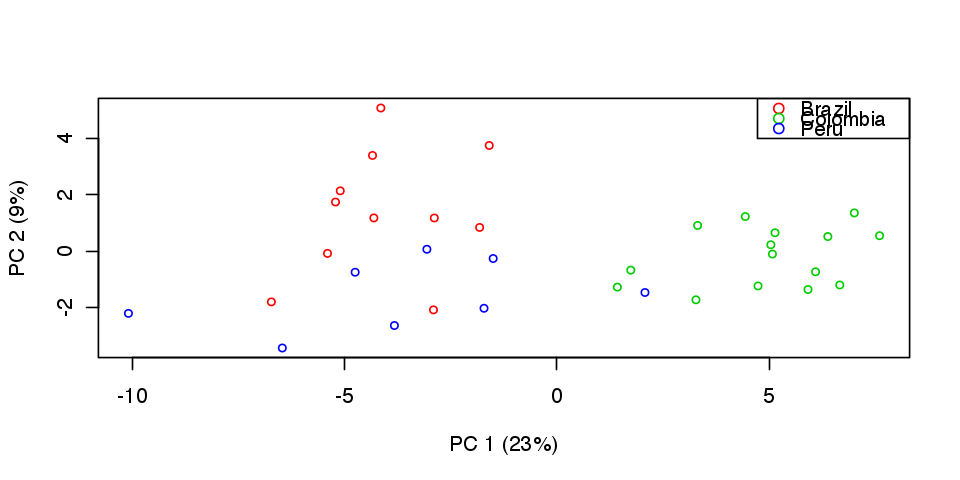

In [309]:
options(repr.plot.width=8, repr.plot.height=4)
pc <- c(1,2)
COLOR <- c(2:4)
ev <- c(round(pca$sdev[pc[1]]/sum(pca$sdev)*100,0),
        round(pca$sdev[pc[2]]/sum(pca$sdev)*100,0),
        round(pca$sdev[pc[3]]/sum(pca$sdev)*100,0))
plot(pca$x[,pc[1]], pca$x[,pc[2]], col=COLOR[d$country], cex=0.7, 
     xlab=paste0("PC ", pc[1], " (", ev[pc[1]], "%)"), 
     ylab=paste0("PC ", pc[2], " (", ev[pc[2]], "%)"))
legend("topright", legend=levels(country), col=COLOR, pch=1)

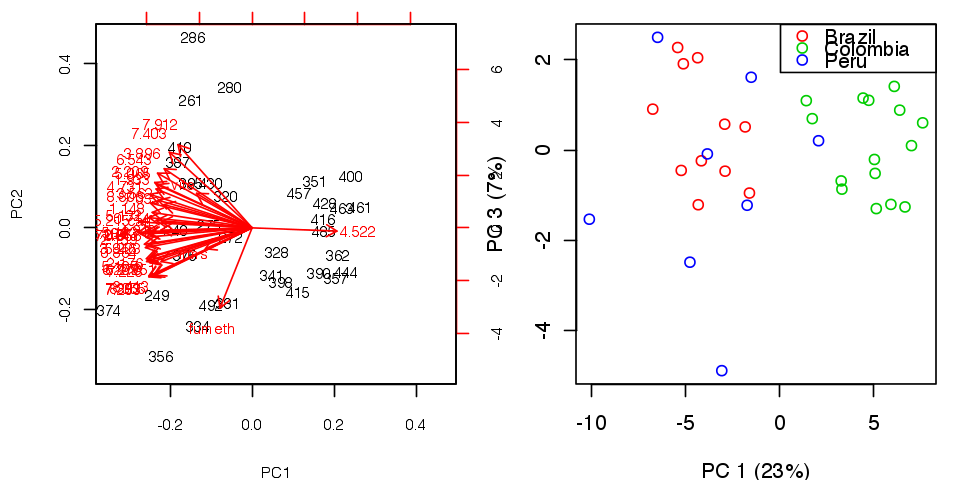

In [310]:
options(repr.plot.width=8, repr.plot.height=4)
pc <- c(1,3)
COLOR <- c(2:4)
PCH <- c(1,16)
pca <- prcomp(d$x)
#pca <- prcomp(d$x,scale=FALSE,center=TRUE)
layout(matrix(c(1,2), 1, 2, byrow = TRUE), widths=c(3,3), heights=c(1)) 
op <- par(mar = c(4,4,1,1))
biplot(pca,cex=0.7,cex.lab=0.7,cex.axis=0.7)
plot(pca$x[,pc[1]], pca$x[,pc[2]], col=COLOR[d$country], cex=PCH[1], xlab=paste0("PC ", pc[1], " (", round(pca$sdev[pc[1]]/sum(pca$sdev)*100,0), "%)"), ylab=paste0("PC ", pc[2], " (", round(pca$sdev[pc[2]]/sum(pca$sdev)*100,0), "%)"))
legend("topright", legend=levels(country), col=COLOR, pch=1)
par(op)

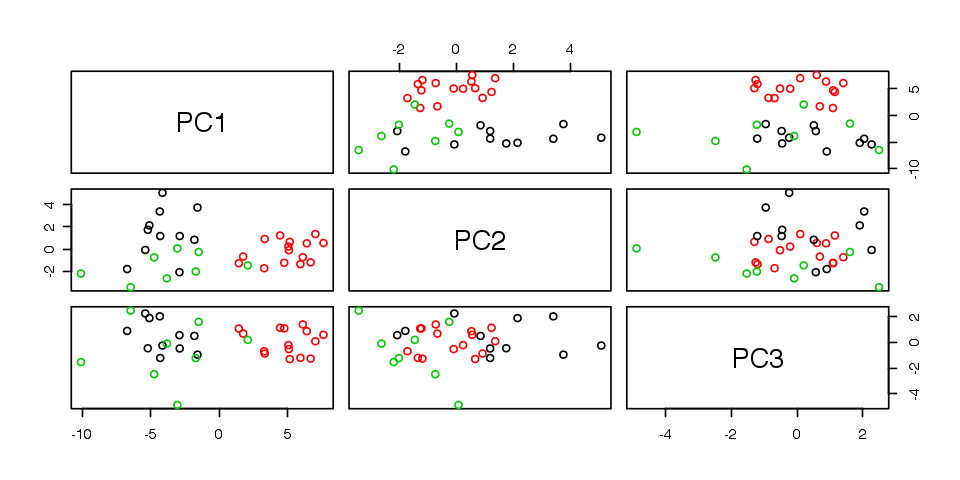

In [311]:
pairs(pca$x[,1:3],col=d$country)


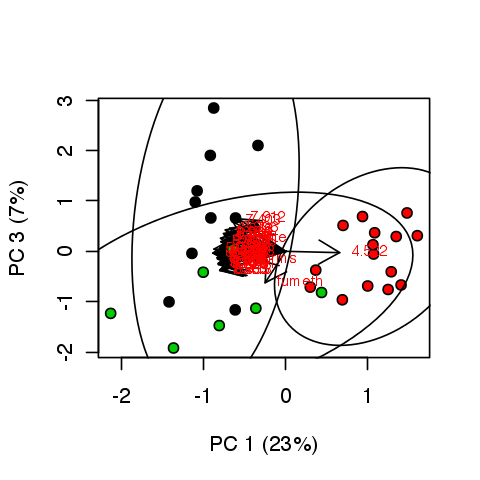

In [312]:
options(repr.plot.width=4, repr.plot.height=4)
prin_comp<-rda(d$x, scale=TRUE)
pca_scores<-scores(prin_comp)
plot(pca_scores$sites[,1],pca_scores$sites[,2], pch=21, bg=as.numeric(d$country),
    arrows(0,0,pca_scores$species[,1],pca_scores$species[,2],lwd=1,length=0.2),
    xlab=paste0("PC ", pc[1], " (", round(pca$sdev[pc[1]]/sum(pca$sdev)*100,0), "%)"), ylab=paste0("PC ", pc[2], " (", round(pca$sdev[pc[2]]/sum(pca$sdev)*100,0), "%)"))
ordiellipse(prin_comp,d$country,conf=0.99)
text(pca_scores$species[,1],pca_scores$species[,2],colnames(d$x),cex=0.7,pos=4,col="red")

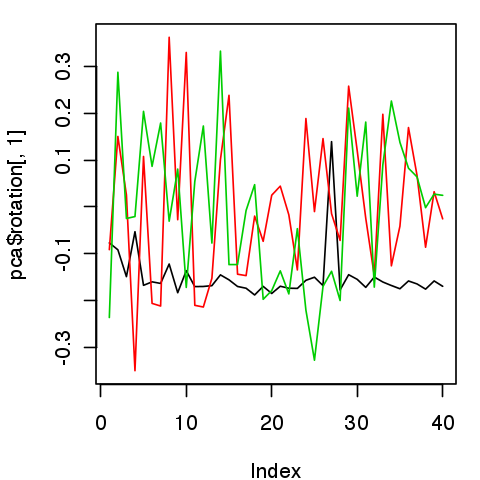

In [313]:
op <- par(mar = c(4,4,1,1))
plot(pca$rotation[,1], type='l', ylim=range(pca$rotation[,1:3]))
lines(pca$rotation[,2], type='l', col=2)
lines(pca$rotation[,3], type='l', col=3)
par(op)

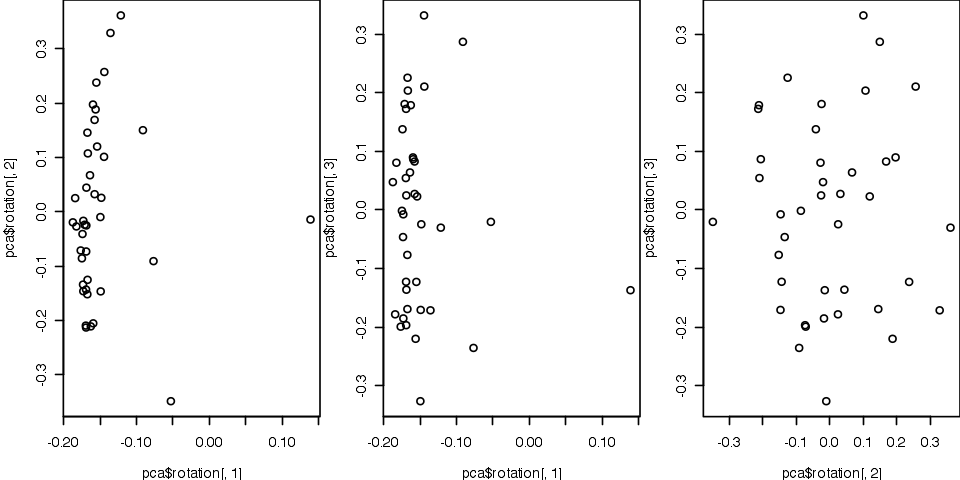

In [314]:
options(repr.plot.width=8, repr.plot.height=4)
layout(matrix(c(1,2,3), 1, 3, byrow = TRUE), 
       widths=c(3,3,3), 
       heights=c(1)) 
op <- par(mar = c(4,4,0,0))
plot(pca$rotation[,1],pca$rotation[,2]); 
plot(pca$rotation[,1],pca$rotation[,3]); 
plot(pca$rotation[,2],pca$rotation[,3])
par(op)

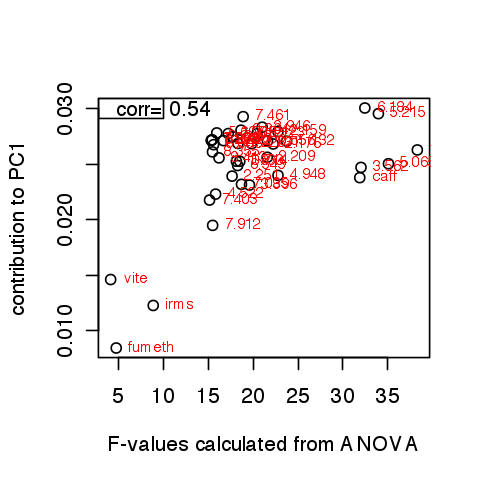

In [315]:
options(repr.plot.width=4, repr.plot.height=4)
aload <- abs(pca$rotation)
contrib <- sweep(aload, 2, colSums(aload), "/")

plot(fvalues[],contrib[,pc[1]],
     xlab="F-values calculated from ANOVA", 
     ylab=paste0("contribution to PC",pc[1]))
text(fvalues[],contrib[,pc[1]],colnames(d$x),cex=0.7,pos=4,col="red")
legend('topleft', 
       legend=paste("corr=",round(cor(fvalues,contrib[,pc[1]]),2)))

In [316]:
x <- cbind(irms,vite,caff,fumeth,as.matrix(coffeeMulti$nmrBin[,ffilter]))
C <- findCorrelation(cor(x), cutoff = .90, verbose = FALSE)
fvalues <- c(8.879,4.14,31.87,4.76,resultsF[ffilter]) # we apply the filter
x <- scale(x, center=TRUE)
d <- data.frame("x"=I(as.matrix(x)), "country"=country)
rownames(d$x)<-1:nrow(d) #to have the numbers according to the index in the matrix
pca <- prcomp(d$x)
aload <- abs(pca$rotation)
contrib <- sweep(aload, 2, colSums(aload), "/")
op <- par(mar = c(4,4,0,0))

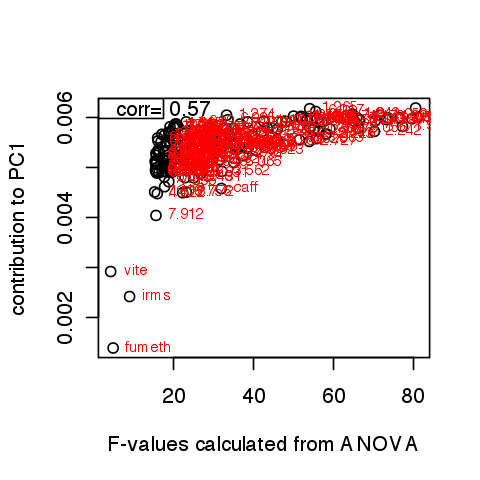

In [317]:

plot(fvalues[],contrib[,pc[1]],xlab="F-values calculated from ANOVA", ylab=paste0("contribution to PC",pc[1]))
text(fvalues[],contrib[,pc[1]],colnames(d$x),cex=0.7,pos=4,col="red")
legend('topleft', legend=paste("corr=",round(cor(fvalues,contrib[,pc[1]]),2)))
par(op)

### conclusions

- irms, gc-ms and nmr are not complementary
- the same molecules are detected and therefore no additional value is gained

## PLS

In [318]:
library(caret)
options(repr.plot.width=4, repr.plot.height=4)

In [348]:
m<-matrix(sample(0:140,140), nrow= 20,ncol =7, byrow="TRUE")

species<-c("1", "1", "1","1", "1", "1","1", "1", "1","1",
           "-1","-1","-1","-1","-1","-1","-1","-1","-1","-1")

M<-data.frame(m,species)
X<-m
Y<-as.numeric(species)


In [349]:
M[c(1,2,19,20),]

,X1,X2,X3,X4,X5,X6,X7,species
1,103,50,92,98,91,84,31,1
2,56,89,0,106,129,44,75,1
19,52,26,93,70,69,28,71,-1
20,48,62,72,22,139,108,135,-1


In [350]:
nf = dim(X)[1]
T = c()
P = c()
C = c()
W = c()

In [351]:
for (j in 1:nf) {
  w = (t(X) %*% Y) %*% solve(t(Y) %*% Y)
  w1 = t(w) %*% w
  w2 = abs(sqrt(w1))
  w = w %*% solve(w2)
  t = (X %*% w)
  t1 = t(t) %*% t
  c = t(Y) %*% t %*% solve(t1)
  c1 = t(c) %*% c
  u = Y %*% c %*% solve(c1)
  u1 = t(u) %*% u
  u2 = abs(sqrt(u1))
  p = (t(X) %*% t) %*% solve(t1)
  X = X - (t)%*%t(p)
  T = matrix(c(T, t))
  P = matrix(c(P, p))
  C = matrix(c(C, c))
  W = matrix(c(W, w))
}

In [352]:
T = matrix(T, ncol = nf)
T = scale(T, scale = TRUE, center = TRUE)
P = matrix(P, ncol = nf)
C = matrix(C, ncol = nf)
W = matrix(W, ncol = nf)


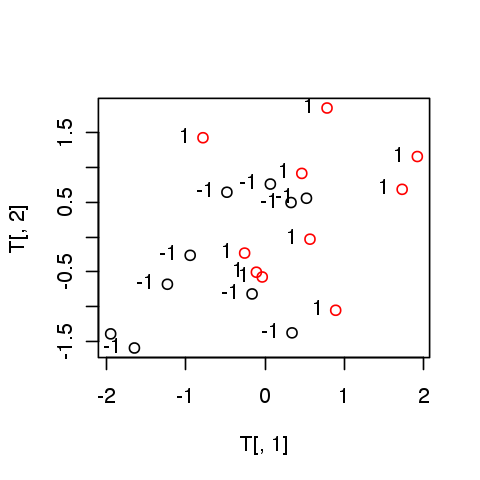

In [353]:
plot(T[,1], T[,2], col = factor(species))
text(T[,1], T[,2], species, pos = 2)


## o-PLS

In [378]:
m<-matrix(sample(6e6:7e6,140), nrow= 20,ncol =7, byrow="TRUE")

In [379]:
species<-c("1", "1", "1","1", "1", "1","1", "1", "1","1",
           "-1","-1","-1","-1","-1","-1","-1","-1","-1","-1")

M<-data.frame(m,species)
X<-m
Y<-as.numeric(species)
nf=15

T = c()
P = c()
C = c()
W = c()
Tortho = c()
Portho = c()
Wortho = c()
Cortho = c()

In [380]:
for (j in 1:nf) {
  w = (t(X) %*% Y) %*% solve(t(Y) %*% Y)
  w=w%*%solve(norm(w))
  t = (X %*% w) %*% solve(t(w) %*% w)
  c = t(Y) %*% t %*% solve(t(t) %*% t)
  u = Y %*% c %*% solve(t(c) %*% c)
  p = (t(X) %*% t) %*% solve(t(t) %*% t)
  wortho = p - w
  wortho= p - t(((t(w)%*%p)%*% solve(t(w)%*%w))%*% t(w))
  wortho= wortho%*%solve(norm(wortho))
  tortho = X %*% wortho %*% solve(t(wortho) %*% wortho)
  portho = t(X) %*% tortho %*% solve(t(tortho) %*% tortho)
  cortho = t(Y) %*% tortho %*% solve(t(tortho) %*% tortho)
  X = X - tortho %*% t(portho)
  T = matrix(c(T, t))
  P = matrix(c(P, p))
  C = matrix(c(C, c))
  W = matrix(c(W, w))
  Tortho = matrix(c(Tortho, tortho))
  Portho = matrix(c(Portho, portho))
  Wortho = matrix(c(Wortho, wortho))
  Cortho = matrix(c(Cortho, cortho))
}

In [381]:
T = matrix(T, ncol = nf)
T = scale(T, scale = TRUE, center = TRUE)
P = matrix(P, ncol = nf)
C = matrix(C, ncol = nf)
W = matrix(W, ncol = nf)
Tortho = matrix(Tortho, ncol = nf)
Tortho = scale(Tortho, scale = TRUE, center = TRUE)
Portho = matrix(Portho, ncol = nf)
Wortho = matrix(Wortho, ncol = nf)
Xortho = Tortho %*% t(Portho)

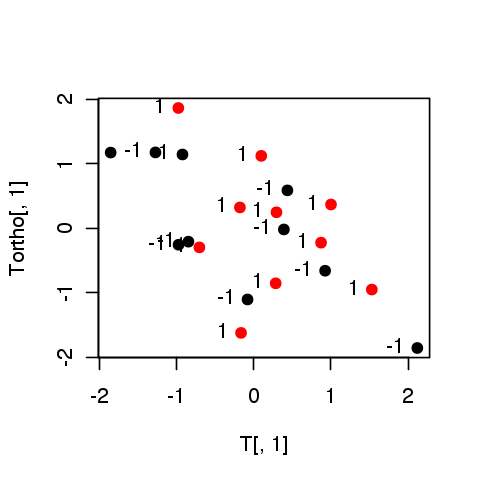

In [382]:
plot(T[,1], Tortho[, 1], pch = 19, col=factor(species))
text(T[, 1], Tortho[,1],species, cex=1, pos=2)

In [386]:
m<-matrix(sample(6e6:7e6,1400), nrow= 20,ncol =70, byrow="TRUE")

In [387]:
species<-c("1", "1", "1","1", "1", "1","1", "1", "1","1",
           "-1","-1","-1","-1","-1","-1","-1","-1","-1","-1")

M<-data.frame(m,species)
X<-m
Y<-as.numeric(species)
nf=15

T = c()
P = c()
C = c()
W = c()
Tortho = c()
Portho = c()
Wortho = c()
Cortho = c()
for (j in 1:nf) {
  w = (t(X) %*% Y) %*% solve(t(Y) %*% Y)
  w=w%*%solve(norm(w))
  t = (X %*% w) %*% solve(t(w) %*% w)
  c = t(Y) %*% t %*% solve(t(t) %*% t)
  u = Y %*% c %*% solve(t(c) %*% c)
  p = (t(X) %*% t) %*% solve(t(t) %*% t)
  wortho = p - w
  wortho= p - t(((t(w)%*%p)%*% solve(t(w)%*%w))%*% t(w))
  wortho= wortho%*%solve(norm(wortho))
  tortho = X %*% wortho %*% solve(t(wortho) %*% wortho)
  portho = t(X) %*% tortho %*% solve(t(tortho) %*% tortho)
  cortho = t(Y) %*% tortho %*% solve(t(tortho) %*% tortho)
  X = X - tortho %*% t(portho)
  T = matrix(c(T, t))
  P = matrix(c(P, p))
  C = matrix(c(C, c))
  W = matrix(c(W, w))
  Tortho = matrix(c(Tortho, tortho))
  Portho = matrix(c(Portho, portho))
  Wortho = matrix(c(Wortho, wortho))
  Cortho = matrix(c(Cortho, cortho))
}
T = matrix(T, ncol = nf)
T = scale(T, scale = TRUE, center = TRUE)
P = matrix(P, ncol = nf)
C = matrix(C, ncol = nf)
W = matrix(W, ncol = nf)
Tortho = matrix(Tortho, ncol = nf)
Tortho = scale(Tortho, scale = TRUE, center = TRUE)
Portho = matrix(Portho, ncol = nf)
Wortho = matrix(Wortho, ncol = nf)
Xortho = Tortho %*% t(Portho)


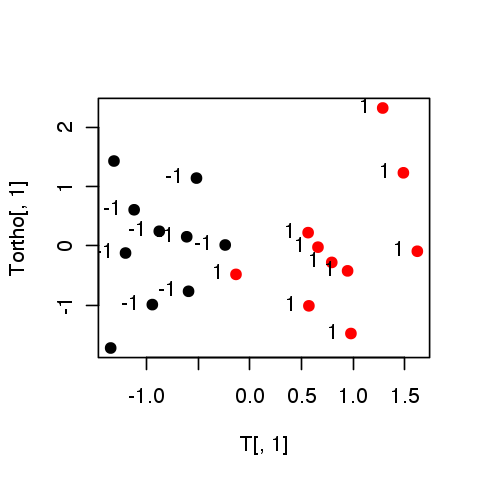

In [388]:
plot(T[,1], Tortho[, 1], pch = 19, col=factor(species))
text(T[, 1], Tortho[,1],species, cex=1, pos=2)

## Conclusions

- this is a code for teaching (not validated)
- we can get inspiration for creating a new publication style

<center><img src="../img/cloud3-04.png" width="500"></center>


Loading required package: rjson

Attaching package: 'rLims'

The following object is masked from 'package:ggplot2':

    lims

Warning message:
In lims.getParameters(entries): NA found in parameters, please check

[1] "number of spectra ordered by experiment type:"

                     cpmgpr1dcomp     hmbcgplpndqf  hsqcdietgpsisp2 
               3                2                2                2 
        mlevphpr  noesygpphwgx1jw      noesygppr1d noesygpps1d.comp 
               2                2                1                2 
 noesygpps1dcomp             zg30           zgpg30 
              96                1                2 
[1] "number of spectra ordered by solvents:"

                        CDCl3 COFFEEcalctemp     COFFEEmeoh            D2O 
             2              4              5             78              8 
        H2OD2O           MeOD 
             1             17 
[1] "number of spectra ordered by nucleus:"

13C  1H   C 
  2 111   2 
[1] "number of spectra ordered by temperature:"

300 
109 
[1] "total number of spectra:  115"


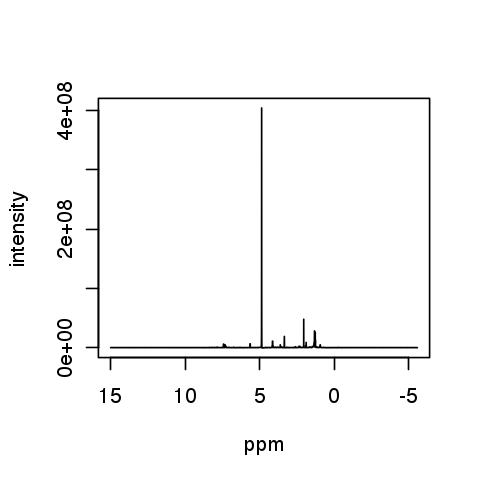

In [478]:
#library(devtools)
#install_github("jwist/rLims")
library(rLims)
account <- list(server='mylims.univalle.edu.co',user='jessica.medina@correounivalle.edu.co',key='PDfEZzKo3K')
metaData <- lims.getUserSamplesMetaData(account=account)
metaData <- lims.selectSamples(metaData,c(7:8))
Filter <- list('experiment'=c('noesygpps1dcomp'))
data <- lims.getSpectra(metaData, Filter=Filter,OP='AND',dry=FALSE)
plot(data$spectra[[2]])
#dataSet <- lims.createDataSet(data)
